# Import libraries and modules

Here, in the first step we are importing all the necessary libraries and packages, these packages makes importing and analyzing data much easier.

Pandas is a software library for data manipulation and analysis using Python.
Numpy is a library for the Python that supports large, multi-dimensional arrays and matrices.
Matplot is the library that helps in creating plots, figures and vizualiization of data.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import random

In [2]:
DATA = pd.read_csv('//home//abhishek//Programs_practice//Machine_Learning//Projects_Practice//Energy_Consumption_Prediction_ML//energydata_complete.csv')

# About the data

This data set contains experimental data recoded during the experiments performed to analyse appliances energy use in a low energy building. The were experiments performed by University in Mons, Belgium and they own all rights to this datas set.

Data used include measurements of temperature and humidity sensors from a wireless network, weather from
a nearby airport station and recorded energy use of lighting fixtures. The data was recorded at every 10 minutes fro about 4.5 months. The house temperature and humidity conditions were monitored with a ZigBee wireless sensor network. Each wireless node transmitted the temperature and humidity conditions around 3.3 minutes. Then, the wireless data was averaged for 10 minutes periods. The energy data was logged every 10 minutes. Weather from the nearest airport weather station (Chievres Airport, Belgium) was downloaded from a public data set from Reliable Prognosis (rp5.ru), and merged together with the experimental data sets using the date and time column. Two random variables have been included in the data set for testing the regression models and to filter out non predictive attributes (parameters).


The columns in this data set are in form of nomenclatures and the details of each are as follows:

1. date time year-month-day hour:minute:second
2. Appliances, energy use in Wh
3. lights, energy use of light fixtures in the house in Wh
4. T1, Temperature in kitchen area, in Celsius
5. RH_1, Humidity in kitchen area, in percentage
6. T2, Temperature in living room area, in Celsius
7. RH_2, Humidity in living room area, in percentage
8. T3, Temperature in laundry room area
9. RH_3, Humidity in laundry room area, in percentage
10. T4, Temperature in office room, in Celsius
11. RH_4, Humidity in office room, in percentage
12. T5, Temperature in bathroom, in Celsius
13. RH_5, Humidity in bathroom, in percentage
14. T6, Temperature outside the building (north side), in Celsius
15. RH_6, Humidity outside the building (north side), in percentage
16. T7, Temperature in ironing room , in Celsius
17. RH_7, Humidity in ironing room, in percentage
18. T8, Temperature in teenager room 2, in Celsius
19. RH_8, Humidity in teenager room 2, in percentage
20. T9, Temperature in parents room, in Celsius
21. RH_9, Humidity in parents room, in percentage
22. T_out, Temperature outside (from Chievres weather station), in Celsius
23. Pressure (from Chievres weather station), in mm Hg
24. RH_out, Humidity outside (from Chievres weather station), in percentage
25. Wind speed (from Chievres weather station), in m/s
26. Visibility (from Chievres weather station), in km
27. Tdewpoint (from Chievres weather station), Â°C
28. rv1, Random variable 1, nondimensional
29. rv2, Random variable 2, nondimensional

For more information about the data collection, scripts and figures, please refer to the paper :
Luis M. Candanedo, Veronique Feldheim, Dominique Deramaix, Data driven prediction models of energy use of appliances in a low-energy house, Energy and Buildings, Volume 140, 1 April 2017, Pages 81-97, ISSN 0378-7788

# Exploratory Data Analysis

blah blah blah
$$c = \sqrt{a^2 + b^2}$$

In [3]:
print(DATA.shape,'\n')
print(DATA.columns,'\n')
DATA.info()

(19735, 29) 

Index(['date', 'Appliances', 'lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3',
       'RH_3', 'T4', 'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8',
       'RH_8', 'T9', 'RH_9', 'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed',
       'Visibility', 'Tdewpoint', 'rv1', 'rv2'],
      dtype='object') 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19735 entries, 0 to 19734
Data columns (total 29 columns):
date           19735 non-null object
Appliances     19735 non-null int64
lights         19735 non-null int64
T1             19735 non-null float64
RH_1           19735 non-null float64
T2             19735 non-null float64
RH_2           19735 non-null float64
T3             19735 non-null float64
RH_3           19735 non-null float64
T4             19735 non-null float64
RH_4           19735 non-null float64
T5             19735 non-null float64
RH_5           19735 non-null float64
T6             19735 non-null float64
RH_6           19735 non-null float64
T7           

In [4]:
DATA.head()

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,...,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,...,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,...,17.000000,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1,28.642668,28.642668
3,2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,...,17.000000,45.40,6.250000,733.8,92.0,6.000000,51.500000,5.0,45.410389,45.410389
4,2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,...,17.000000,45.40,6.133333,733.9,92.0,5.666667,47.666667,4.9,10.084097,10.084097


In [4]:
dframe = DATA[['Appliances', 'lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3','RH_3','T6', 'RH_6', 'T7', 'RH_7',
               'T_out','Press_mm_hg', 'RH_out', 'Windspeed']]
dframe.corr()

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T6,RH_6,T7,RH_7,T_out,Press_mm_hg,RH_out,Windspeed
Appliances,1.000000,0.197278,0.055447,0.086031,0.120073,-0.060465,0.085060,0.036292,0.117638,-0.083178,0.025801,-0.055642,0.099155,-0.034885,-0.152282,0.087122
lights,0.197278,1.000000,-0.023528,0.106968,-0.005622,0.050985,-0.097393,0.131161,-0.079029,0.153756,-0.135347,0.035069,-0.074424,-0.010576,0.068543,0.060281
T1,0.055447,-0.023528,1.000000,0.164006,0.836834,-0.002509,0.892402,-0.028550,0.654769,-0.615045,0.838705,0.135182,0.682846,-0.150574,-0.345481,-0.087654
RH_1,0.086031,0.106968,0.164006,1.000000,0.269839,0.797535,0.253230,0.844677,0.316141,0.245126,0.021397,0.801122,0.340767,-0.293957,0.274126,0.204932
T2,0.120073,-0.005622,0.836834,0.269839,1.000000,-0.165610,0.735245,0.121497,0.801186,-0.580372,0.663660,0.229212,0.792255,-0.133028,-0.505291,0.052495
RH_2,-0.060465,0.050985,-0.002509,0.797535,-0.165610,1.000000,0.137319,0.678326,-0.009670,0.389933,-0.051422,0.690584,0.033674,-0.255646,0.584911,0.069190
T3,0.085060,-0.097393,0.892402,0.253230,0.735245,0.137319,1.000000,-0.011234,0.686882,-0.647672,0.847374,0.172624,0.699417,-0.189974,-0.281718,-0.100776
RH_3,0.036292,0.131161,-0.028550,0.844677,0.121497,0.678326,-0.011234,1.000000,0.076833,0.514912,-0.250090,0.832685,0.118207,-0.233274,0.356192,0.263188
T6,0.117638,-0.079029,0.654769,0.316141,0.801186,-0.009670,0.686882,0.076833,1.000000,-0.672137,0.619085,0.256077,0.974787,-0.141643,-0.569119,0.169185
RH_6,-0.083178,0.153756,-0.615045,0.245126,-0.580372,0.389933,-0.647672,0.514912,-0.672137,1.000000,-0.753973,0.357222,-0.641572,-0.065814,0.718587,0.098317


In [22]:
dset = DATA[['Appliances', 'lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3','RH_3']]

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fa0474ca950>,
      dtype=object)

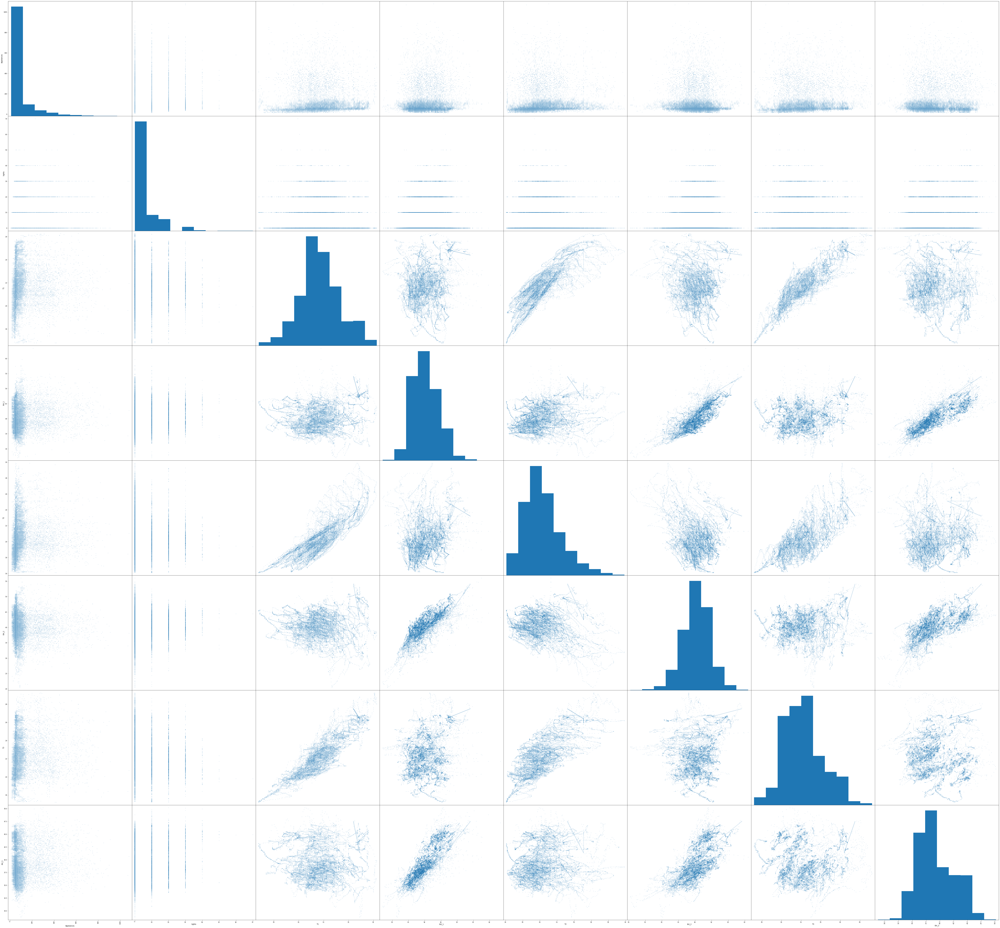

In [23]:
pd.plotting.scatter_matrix(dset,alpha=0.2,figsize=(105.32,100.35))

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fb0f31f7450>,
      dtype=object)

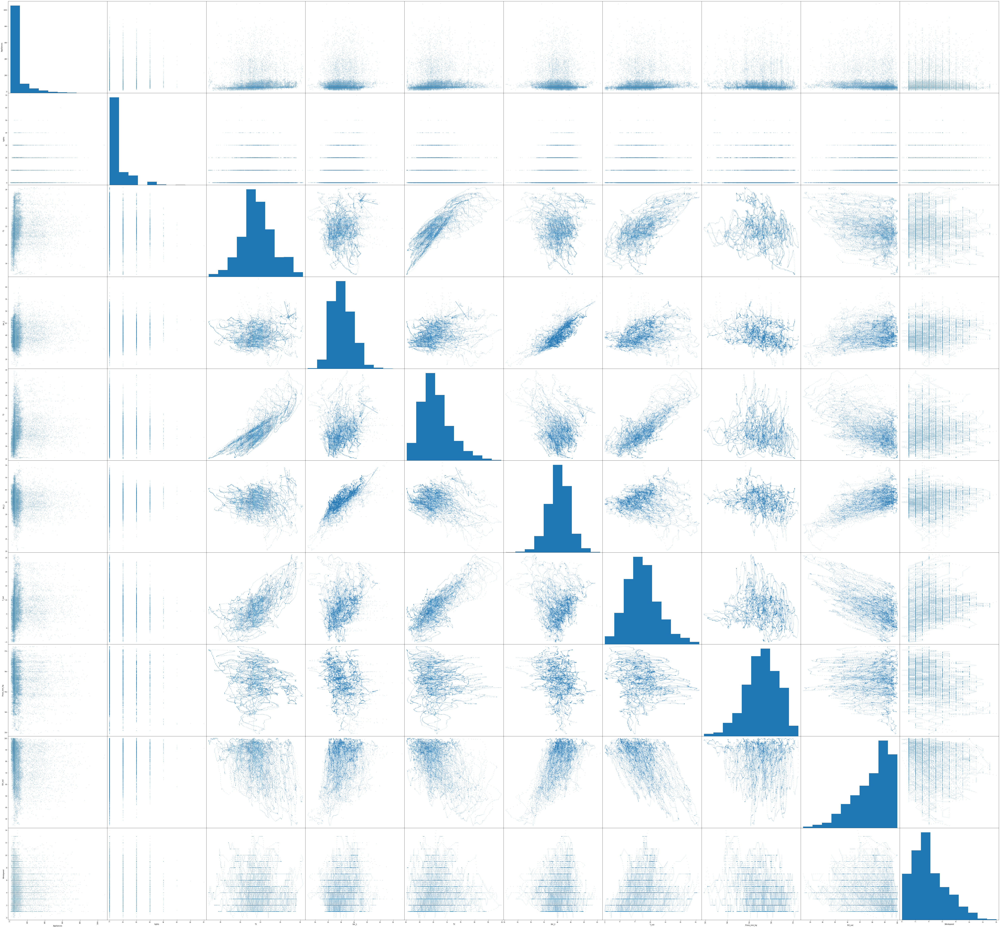

In [22]:
#pd.plotting.scatter_matrix(dframe,alpha=0.2,figsize=(105.32,100.35))

Text(0.5, 0, 'Temperature')

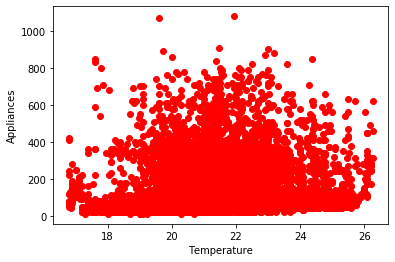

In [7]:
plt.scatter(dframe.T1,dframe.Appliances, color='red')
plt.ylabel('Appliances')
plt.xlabel('Temperature')

Text(0, 0.5, 'Power usage of appliance')

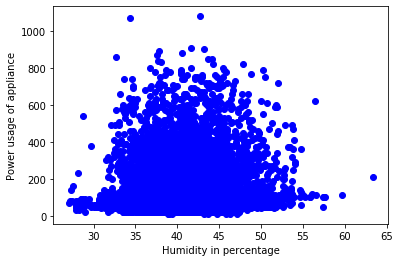

In [8]:
plt.scatter(dframe.RH_1, dframe.Appliances, color='blue')
plt.xlabel('Humidity in percentage')
plt.ylabel('Power usage of appliance')

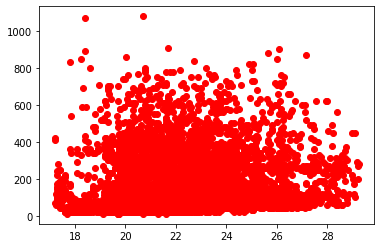

In [28]:
plt.scatter(dframe.T3,dframe.Appliances, color='red')

Text(0, 0.5, 'Temperature outside')

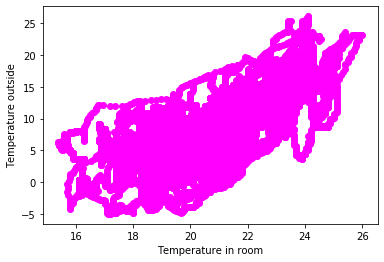

In [37]:
plt.scatter(dframe.T7,dframe.T_out, color='magenta')
plt.xlabel('Temperature in room')
plt.ylabel('Temperature outside')

Text(0, 0.5, 'Appliances')

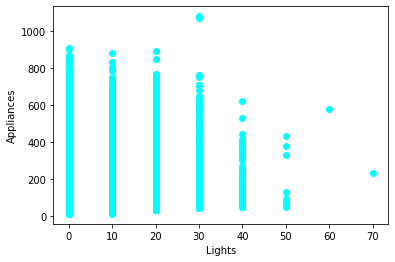

In [36]:
plt.scatter(dframe.lights,dframe.Appliances,color='cyan')
plt.xlabel('Lights')
plt.ylabel('Appliances')

# Prediction using Linear Regression model 

Using the Linear Regression analysis

## Splitting the data

In this step we are splitting the data into two, i.e. test and train data.
The test data comprises of about 70% or 80% of the orignal data and is used to train the regression model. We are using random module to randomly select from the data for train set, this is done to ensure a random sampling of train data in order to make sure that model calculates the best fit line considering the randomness of the values in data instead of following the pattern of initial data values.

In [19]:
msk = np.random.rand(len(dframe)) < 0.8
trainSet = DATA[msk]
testSet = DATA[~msk]

In [14]:
from sklearn import linear_model
regressionModel = linear_model.LinearRegression()

train_x = np.asanyarray(trainSet[[ 'T1','RH_1', 'RH_2','RH_3', 'RH_4', 'RH_5', 'RH_6', 'RH_7', 'RH_8', 
                                  'RH_9', 'T_out', 'RH_out']])

#train_x = np.asanyarray(trainSet[['T1', 'RH_1', 'T2', 'RH_2', 'T3','RH_3', 'T4', 'RH_4', 'T5', 'RH_5', 'T6', 
#                                  'RH_6', 'T7', 'RH_7', 'T8','RH_8', 'T9', 'RH_9', 'T_out', 'RH_out']])

train_y = np.asanyarray(trainSet[['Appliances']])
regressionModel.fit(train_x,train_y)
print('Coefficients : ',regressionModel.coef_)

print('Intercept : ',regressionModel.intercept_)


Coefficients :  [[12.72450121 -6.9186961   4.62222156  0.85579856  0.11462383  0.05957941
  -3.48007121 -4.62431377 -1.62963429  0.45524649  0.08901594]]
Intercept :  [20.03694914]


In [17]:
test_x = np.asanyarray(trainSet[[ 'RH_1', 'RH_2','RH_3', 'RH_4', 'RH_5', 'RH_6', 'RH_7', 'RH_8', 
                                  'RH_9', 'T_out', 'RH_out']])

#test_x = np.asanyarray(testSet[['T1', 'RH_1', 'T2', 'RH_2', 'T3','RH_3', 'T4', 'RH_4', 'T5', 'RH_5', 'T6', 
#                                  'RH_6', 'T7', 'RH_7', 'T8','RH_8', 'T9', 'RH_9', 'T_out', 'RH_out']])

test_y = np.asanyarray(trainSet[['Appliances']])
test_y_predicted = regressionModel.predict(test_x)
print(test_y_predicted[0:5]-test_y[0:5])



[[78.89158588]
 [68.79393572]
 [74.78433247]
 [68.67047408]
 [61.66236723]]


In [18]:
regressionModel.score(train_x, train_y)

0.09990297438719875